### Exploratory Data Analysis

,time,A,B,C,D,E,F,G,H,I,J,K,L,M,N,Y1,Y2
0,0,0.207366,-0.159951,-0.634176,-0.580962,-0.266505,0.060173,-0.475257,-1.486516,-0.332594,-0.671466,-0.226149,-0.187624,-0.780237,-0.785965,-0.935902,-0.310081
1,1,0.188828,-0.265508,0.042143,-0.550442,-0.132319,-0.185219,0.028295,0.093210,-0.518139,-0.251917,-0.347845,-0.359069,-0.161254,0.020401,-0.089707,-0.305374
2,2,-0.144261,-0.577142,-0.214634,-0.747391,-0.184255,-0.464831,-0.085181,0.700449,-0.603438,0.197773,-0.566696,-0.580799,0.202726,0.135261,-0.077855,-0.631485
3,3,0.208982,-0.310449,0.513708,-0.562868,0.742308,-0.305487,0.762246,1.363020,-0.384575,0.525556,-0.348514,-0.428099,0.548993,0.471031,0.941271,-0.535212
4,4,0.093320,-0.358156,0.173188,-0.687296,-0.161461,-0.116062,-0.245748,0.863372,-0.655588,-0.263358,-0.557428,-0.481214,0.083602,0.003087,-0.039582,-0.490561


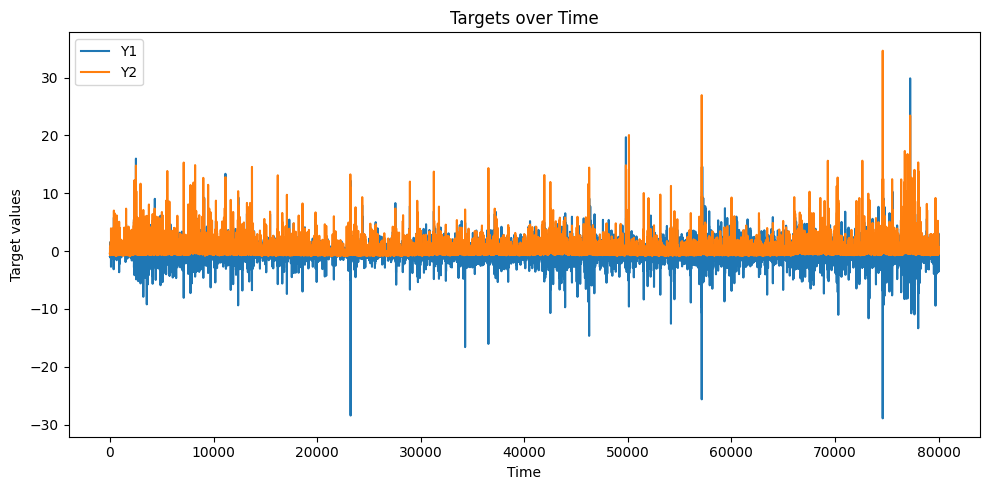

In [25]:
import pandas as pd
import matplotlib.pyplot as plt

df = pd.read_csv("train.csv")
display(df.head())

fig, ax = plt.subplots(figsize=(10, 5))
ax.plot(df["time"], df["Y1"], label="Y1")
ax.plot(df["time"], df["Y2"], label="Y2")
ax.set_xlabel("Time")
ax.set_ylabel("Target values")
ax.set_title("Targets over Time")
ax.legend()
plt.tight_layout()
plt.show()


In [88]:
import pandas as pd
import plotly.graph_objects as go

df = pd.read_csv("train.csv")
display(df.head())

value_cols = df.columns[df.columns.get_loc("A"): df.columns.get_loc("Y2") + 1]

fig = go.Figure()
for col in value_cols:
    fig.add_trace(
        go.Scatter(
            x=df["time"],
            y=df[col],
            mode="lines",
            name=col,
        )
    )

fig.update_layout(
    title="Train Columns A to Y2 over Time",
    xaxis_title="Time",
    yaxis_title="Value",
)

fig.show()

,time,A,B,C,D,E,F,G,H,I,J,K,L,M,N,Y1,Y2
0,0,0.207366,-0.159951,-0.634176,-0.580962,-0.266505,0.060173,-0.475257,-1.486516,-0.332594,-0.671466,-0.226149,-0.187624,-0.780237,-0.785965,-0.935902,-0.310081
1,1,0.188828,-0.265508,0.042143,-0.550442,-0.132319,-0.185219,0.028295,0.093210,-0.518139,-0.251917,-0.347845,-0.359069,-0.161254,0.020401,-0.089707,-0.305374
2,2,-0.144261,-0.577142,-0.214634,-0.747391,-0.184255,-0.464831,-0.085181,0.700449,-0.603438,0.197773,-0.566696,-0.580799,0.202726,0.135261,-0.077855,-0.631485
3,3,0.208982,-0.310449,0.513708,-0.562868,0.742308,-0.305487,0.762246,1.363020,-0.384575,0.525556,-0.348514,-0.428099,0.548993,0.471031,0.941271,-0.535212
4,4,0.093320,-0.358156,0.173188,-0.687296,-0.161461,-0.116062,-0.245748,0.863372,-0.655588,-0.263358,-0.557428,-0.481214,0.083602,0.003087,-0.039582,-0.490561


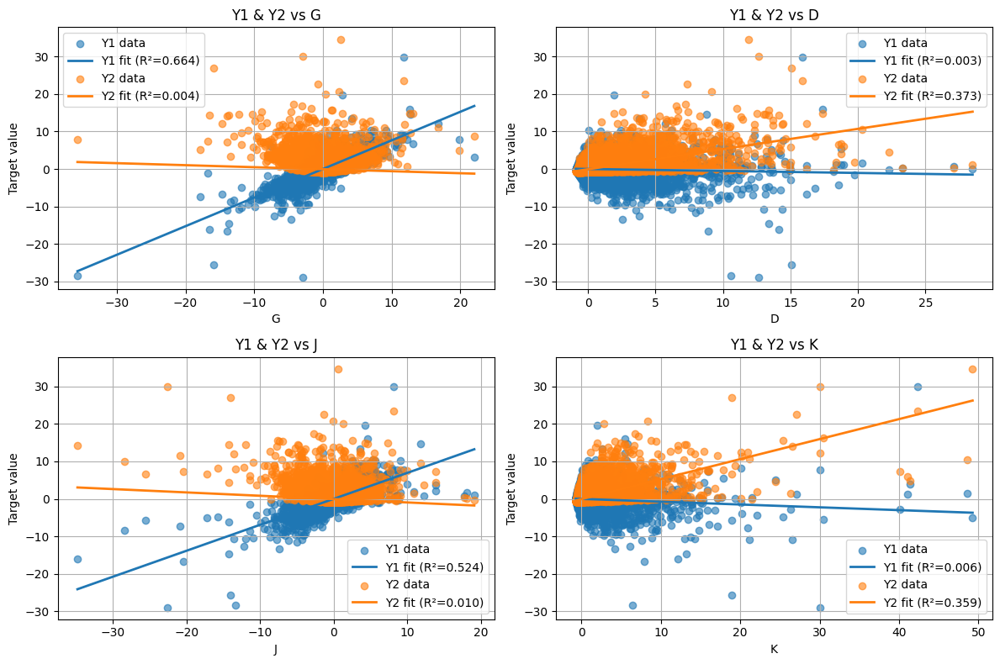


== G ==
Y1: y = 0.762991 * G + -0.00276929   (R²=0.664)
Y2: y = -0.0536489 * G + -0.0611749   (R²=0.004)

== D ==
Y1: y = -0.0529202 * D + -0.00111863   (R²=0.003)
Y2: y = 0.538961 * D + -0.0783721   (R²=0.373)

== J ==
Y1: y = 0.692113 * J + -0.00278842   (R²=0.524)
Y2: y = -0.0891488 * J + -0.0611747   (R²=0.010)

== K ==
Y1: y = -0.074992 * K + -0.00286765   (R²=0.006)
Y2: y = 0.533201 * K + -0.0607443   (R²=0.359)


In [57]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

def plot_lr_two_targets_grid(df: pd.DataFrame, features, y_cols=("Y1", "Y2")):
    """
    Create a 2x2 grid of subplots. Each subplot shows scatter + linear fits
    for the two target columns (default Y1, Y2) against one selected feature.

    Parameters
    ----------
    df : pd.DataFrame
        Source data.
    features : list/tuple of str
        Exactly four feature column names to visualize.
    y_cols : tuple of str
        Target column names, default ("Y1", "Y2").
    """
    # ---- validations ----
    if len(features) != 4:
        raise ValueError(f"`features` must have exactly 4 items, got {len(features)}.")

    missing = [c for c in [*features, *y_cols] if c not in df.columns]
    if missing:
        raise KeyError(f"Missing columns: {missing}")

    # ---- helper to compute model, preds, r2 ----
    def fit_lr(x, y):
        model = LinearRegression()
        model.fit(x, y)
        y_pred = model.predict(x)
        r2 = r2_score(y, y_pred)
        return model, y_pred, r2

    fig, axes = plt.subplots(2, 2, figsize=(12, 8))
    axes = axes.ravel()

    all_equations = []  # collect equations for printing

    for ax, feature in zip(axes, features):
        # Keep only what we need and force numeric, drop NA
        cols = [feature, *y_cols]
        data = df[cols].apply(pd.to_numeric, errors="coerce").dropna()
        if data.empty:
            raise ValueError(f"No valid rows left for feature '{feature}' after cleaning.")

        X = data[[feature]].to_numpy()
        x_min, x_max = X.min(), X.max()
        x_grid = np.linspace(x_min, x_max, 200).reshape(-1, 1)

        # Plot each target
        eqns_this_feature = []
        for y in y_cols:
            yv = data[y].to_numpy()

            model, y_pred, r2 = fit_lr(X, yv)

            # scatter
            ax.scatter(X.ravel(), yv, alpha=0.6, label=f"{y} data")
            # fitted line
            ax.plot(x_grid.ravel(), model.predict(x_grid), linewidth=2, label=f"{y} fit (R²={r2:.3f})")

            eqns_this_feature.append((y, model.coef_[0], model.intercept_, r2))

        ax.set_xlabel(feature)
        ax.set_ylabel("Target value")
        ax.set_title(f"{y_cols[0]} & {y_cols[1]} vs {feature}")
        ax.grid(True)
        ax.legend()

        all_equations.append((feature, eqns_this_feature))

    plt.tight_layout()
    plt.show()

    # ---- print equations for all subplots ----
    for feature, eqns in all_equations:
        print(f"\n== {feature} ==")
        for y, coef, intercept, r2 in eqns:
            print(f"{y}: y = {coef:.6g} * {feature} + {intercept:.6g}   (R²={r2:.3f})")

# ---- Example usage ----
if __name__ == "__main__":
    df = pd.read_csv("train.csv")  # adjust path as needed

    # choose 4 features to visualize (must be exactly 4)
    selected_features = ["G", "D", "J", "K"]   # <-- change these
    plot_lr_two_targets_grid(df, selected_features, y_cols=("Y1", "Y2"))


In [58]:
import pandas as pd
from sklearn.metrics import mean_squared_error, r2_score

# === PARAMETERS YOU CAN EDIT ===
file_path = "train.csv"  # Change if file is elsewhere
features = list("ABCDEFGHIJKLMN")  # Features A to N
targets = ["Y1", "Y2"]  # Targets

# Choose how to sort results (e.g., ["Correlation"], ["R2"], ["MSE"], or multiple)
# sort_by = ["R2"]  # Example: sort by R2 in descending order
sort_by = ["MSE"]  # Example: sort by R2 in descending order

# === FUNCTION TO COMPUTE METRICS ===
def compute_metrics(x, y):
    corr = x.corr(y)
    slope = ((x - x.mean()) * (y - y.mean())).sum() / ((x - x.mean())**2).sum()
    intercept = y.mean() - slope * x.mean()
    y_pred = slope * x + intercept
    r2 = r2_score(y, y_pred)
    mse = mean_squared_error(y, y_pred)
    return corr, r2, mse, slope

# === MAIN ===
train_df = pd.read_csv(file_path)

results = {}
for target in targets:
    metrics_list = []
    for feature in features:
        corr, r2, mse, slope = compute_metrics(train_df[feature], train_df[target])
        metrics_list.append({
            "Feature": feature,
            "Correlation": corr,
            "R2": r2,
            "MSE": mse,
            "Slope": slope
        })
    df = pd.DataFrame(metrics_list)
    df = df.sort_values(by=sort_by, ascending=[False]*len(sort_by))
    results[target] = df

# === DISPLAY RESULTS ===
for target, df in results.items():
    print(f"\nMetrics for {target} (sorted by {sort_by}):")
    display(df)


Metrics for Y1 (sorted by ['MSE']):


,Feature,Correlation,R2,MSE,Slope
0,A,-0.006105,0.000037,0.942125,-0.005496
3,D,-0.057097,0.003260,0.939088,-0.052920
11,L,-0.072366,0.005237,0.937226,-0.066401
5,F,-0.073191,0.005357,0.937113,-0.066446
10,K,-0.080196,0.006431,0.936101,-0.074992
8,I,-0.090226,0.008141,0.934490,-0.082235
1,B,-0.094995,0.009024,0.933658,-0.089431
13,N,0.595766,0.354938,0.607752,0.563962
4,E,0.684297,0.468262,0.500982,0.640991
12,M,0.686246,0.470933,0.498465,0.657726



Metrics for Y2 (sorted by ['MSE']):


,Feature,Correlation,R2,MSE,Slope
4,E,-0.044583,0.001988,0.851518,-0.039741
6,G,-0.060187,0.003622,0.850124,-0.053649
2,C,-0.073009,0.005330,0.848666,-0.066760
13,N,-0.080172,0.006427,0.847730,-0.072221
7,H,-0.086976,0.007565,0.846760,-0.077198
12,M,-0.095326,0.009087,0.845461,-0.086945
9,J,-0.097986,0.009601,0.845022,-0.089149
0,A,0.484746,0.234979,0.652727,0.415259
5,F,0.496667,0.246678,0.642745,0.429087
11,L,0.503546,0.253559,0.636874,0.439688


### Model Prediction Test with Logitstic Regressiion

Y1 threshold = -0.00159111
        Pred 0  Pred 1
True 0    8405    1595
True 1    1554    8446

               precision    recall  f1-score   support

           0      0.844     0.841     0.842     10000
           1      0.841     0.845     0.843     10000

    accuracy                          0.843     20000
   macro avg      0.843     0.843     0.843     20000
weighted avg      0.843     0.843     0.843     20000



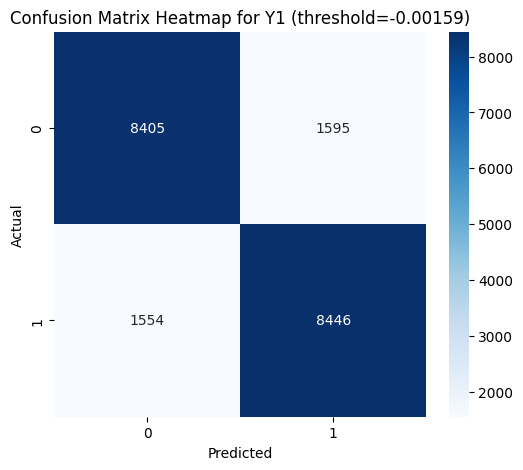

Y2 threshold = -0.318091
        Pred 0  Pred 1
True 0    8413    1587
True 1    2826    7174

               precision    recall  f1-score   support

           0      0.749     0.841     0.792     10000
           1      0.819     0.717     0.765     10000

    accuracy                          0.779     20000
   macro avg      0.784     0.779     0.778     20000
weighted avg      0.784     0.779     0.778     20000



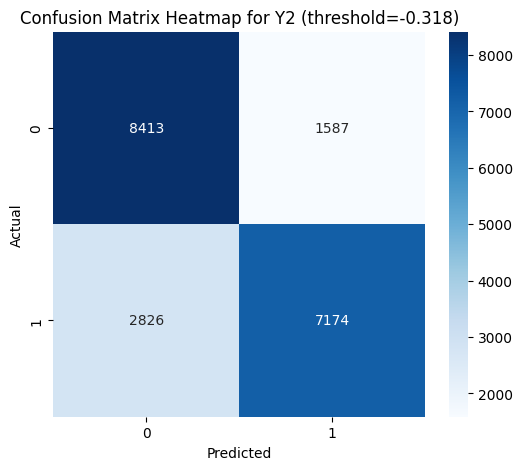

In [73]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, classification_report

# --- load ---
df = pd.read_csv("train.csv")

def plot_confusion_heatmap(
    df: pd.DataFrame,
    target: str = "Y1",
    threshold: str | float = "median",  # "median", "zero", or numeric
    test_size: float = 0.25,
    random_state: int = 42
):
    assert target in df.columns, f"Target {target} not found."
    feature_cols = [c for c in df.columns if c not in ("Y1","Y2")]
    X = df[feature_cols].to_numpy()
    y_cont = df[target].to_numpy()

    # --- binarize target ---
    if threshold == "median":
        t = float(np.nanmedian(y_cont))
    elif threshold == "zero":
        t = 0.0
    else:
        t = float(threshold)
    y = (y_cont > t).astype(int)

    # --- split & scale ---
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=test_size, random_state=random_state, stratify=y
    )
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_test  = scaler.transform(X_test)

    # --- train classifier ---
    clf = LogisticRegression(max_iter=500)
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)

    # --- confusion matrix ---
    cm = confusion_matrix(y_test, y_pred, labels=[0,1])
    print(f"{target} threshold = {t:.6g}")
    print(pd.DataFrame(cm, index=["True 0","True 1"], columns=["Pred 0","Pred 1"]))
    print("\n", classification_report(y_test, y_pred, digits=3))

    # --- plot heatmap ---
    plt.figure(figsize=(6,5))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=[0,1], yticklabels=[0,1])
    plt.title(f"Confusion Matrix Heatmap for {target} (threshold={t:.3g})")
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.show()

    X_raw  = scaler.transform(X)
    y_results = clf.predict(X_raw)

    return y_results

# ---- usage ----
# For Y1
df_y1_pred = plot_confusion_heatmap(df, target="Y1", threshold="median")

# For Y2
df_y2_pred = plot_confusion_heatmap(df, target="Y2", threshold="median")


In [98]:
from plotly.subplots import make_subplots
value_cols = df.columns[df.columns.get_loc("A"): df.columns.get_loc("Y2") + 1]

fig = make_subplots(rows=2, cols=1, shared_xaxes=True, vertical_spacing=0.08)

fig.add_trace(
    go.Scatter(
        x=df["time"],
        y=df["Y1"],
        mode="lines",
        name="original",
    ),
    row=1,
    col=1,
)
fig.add_trace(
    go.Scatter(
        x=df["time"],
        y=df_y1_pred * 3 - 1.5,
        mode="lines",
        name="original",
    ),
    row=1,
    col=1,
)

fig.add_trace(
    go.Scatter(
        x=df["time"],
        y=df["Y2"],
        mode="lines",
        name="predicted",
    ),
    row=2,
    col=1,
)
fig.add_trace(
    go.Scatter(
        x=df["time"],
        y=df_y2_pred,
        mode="lines",
        name="predicted",
    ),
    row=2,
    col=1,
)

fig.update_layout(
    title="Train Columns A to Y2 over Time",
    xaxis_title="Time",
    yaxis_title="Original Value",
    xaxis2_title="Time",
    yaxis2_title="Predicted Value",
    height=700,
)

fig.show()

### Linear Regression Elastic Net, LASSO, and RIDGE

In [105]:
# %% [markdown]
# Linear models with enforced parsimony (Ridge, LASSO, Elastic Net) on train.csv

# %%
import numpy as np
import pandas as pd

from sklearn.model_selection import GridSearchCV, KFold
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Ridge, Lasso, ElasticNet
from sklearn.metrics import make_scorer, r2_score
from sklearn.utils.validation import check_is_fitted
import joblib
from pathlib import Path

# -----------------------------
# 1) Load data
# -----------------------------
path = Path("train.csv")  # adjust if your path is different
df = pd.read_csv(path)

# Infer typical Kaggle-style columns: features are everything except targets
# If your column names differ, tweak this section.
possible_targets = ["Y1", "Y2", "y1", "y2"]
targets = [c for c in df.columns if c in possible_targets]
if not targets:
    raise ValueError(f"Could not find targets {possible_targets} in columns: {list(df.columns)}")

X = df.drop(columns=targets)
y_dict = {t: df[t].values for t in targets}

print(f"Rows: {len(df):,} | Features: {X.shape[1]} | Targets: {targets}")
print("Feature columns:", list(X.columns))

# -----------------------------
# 2) Define models & grids
# -----------------------------
cv = KFold(n_splits=3, shuffle=True, random_state=42)
scorer = make_scorer(r2_score)

def make_pipeline_and_grid(model_name: str):
    if model_name == "ridge":
        pipe = Pipeline([
            ("scaler", StandardScaler(with_mean=True, with_std=True)),
            ("model", Ridge(random_state=42))
        ])
        grid = {
            "model__alpha": np.logspace(-3, 3, 13)  # 1e-3 ... 1e3
        }
    elif model_name == "lasso":
        pipe = Pipeline([
            ("scaler", StandardScaler(with_mean=True, with_std=True)),
            ("model", Lasso(max_iter=20000, random_state=42))
        ])
        grid = {
            "model__alpha": np.logspace(-4, -1, 10)  # 1e-4 ... 1e-1
        }
    elif model_name == "elasticnet":
        pipe = Pipeline([
            ("scaler", StandardScaler(with_mean=True, with_std=True)),
            ("model", ElasticNet(max_iter=30000, random_state=42))
        ])
        grid = {
            "model__alpha": np.logspace(-4, -1, 10),
            "model__l1_ratio": [0.1, 0.3, 0.5, 0.7, 0.8, 0.9]
        }
    else:
        raise ValueError("Unknown model name")
    return pipe, grid

models = ["ridge", "lasso", "elasticnet"]

# -----------------------------
# 3) Train & evaluate
# -----------------------------
results = []
best_models = {}

for target_name, y in y_dict.items():
    print("\n" + "="*80)
    print(f"Target: {target_name}")
    print("="*80)

    for m in models:
        pipe, grid = make_pipeline_and_grid(m)
        gscv = GridSearchCV(
            estimator=pipe,
            param_grid=grid,
            scoring=scorer,
            cv=cv,
            n_jobs=-1,
            refit=True,
            verbose=0,
            return_train_score=False,
        )
        gscv.fit(X, y)

        best_pipe = gscv.best_estimator_
        best_params = gscv.best_params_
        best_score = gscv.best_score_

        # Count non-zero coefficients (post-scaling). We inspect the linear model step.
        model_step = best_pipe.named_steps["model"]
        check_is_fitted(model_step)
        coefs = model_step.coef_.ravel()
        nonzeros = np.sum(~np.isclose(coefs, 0.0, atol=1e-8))
        zeros = coefs.size - nonzeros

        print(f"\nModel: {m.upper()} | CV R²: {best_score:.6f}")
        print("Best params:", best_params)
        print(f"Non-zero coefficients: {nonzeros} / {coefs.size} (zeros: {zeros})")

        results.append({
            "target": target_name,
            "model": m,
            "cv_r2": best_score,
            "non_zero": int(nonzeros),
            "n_features": int(coefs.size),
            "best_params": best_params
        })
        best_models[(target_name, m)] = best_pipe

# -----------------------------
# 4) Summary table
# -----------------------------
summary = pd.DataFrame(results).sort_values(by=["target", "cv_r2"], ascending=[True, False])
print("\n" + "-"*80)
print("Summary (higher R² is better):")
print(summary.to_string(index=False))

# -----------------------------
# 5) Pick winners & save
# -----------------------------
out_dir = Path("./models_linear")
out_dir.mkdir(parents=True, exist_ok=True)

winners = (
    summary.loc[summary.groupby("target")["cv_r2"].idxmax()]
    .reset_index(drop=True)
)

print("\n" + "-"*80)
print("Winners per target:")
print(winners.to_string(index=False))

# Save the winning pipelines for each target, and optionally all three per target
for _, row in winners.iterrows():
    t = row["target"]; m = row["model"]
    joblib.dump(best_models[(t, m)], out_dir / f"{t}_{m}_best_pipeline.joblib")

# (Optional) Save all models too
for (t, m), pipe in best_models.items():
    joblib.dump(pipe, out_dir / f"{t}_{m}_pipeline.joblib")

print(f"\nSaved models to: {out_dir.resolve()}")


Rows: 80,000 | Features: 15 | Targets: ['Y1', 'Y2']
Feature columns: ['time', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N']

Target: Y1

Model: RIDGE | CV R²: 0.755945
Best params: {'model__alpha': np.float64(316.22776601683796)}
Non-zero coefficients: 15 / 15 (zeros: 0)

Model: LASSO | CV R²: 0.755960
Best params: {'model__alpha': np.float64(0.001)}
Non-zero coefficients: 13 / 15 (zeros: 2)

Model: ELASTICNET | CV R²: 0.755963
Best params: {'model__alpha': np.float64(0.004641588833612777), 'model__l1_ratio': 0.3}
Non-zero coefficients: 13 / 15 (zeros: 2)

Target: Y2

Model: RIDGE | CV R²: 0.626178
Best params: {'model__alpha': np.float64(316.22776601683796)}
Non-zero coefficients: 15 / 15 (zeros: 0)

Model: LASSO | CV R²: 0.626181
Best params: {'model__alpha': np.float64(0.001)}
Non-zero coefficients: 15 / 15 (zeros: 0)

Model: ELASTICNET | CV R²: 0.626189
Best params: {'model__alpha': np.float64(0.004641588833612777), 'model__l1_ratio': 0.1}
Non-zero coefficie

In [108]:
# %% [markdown]
# One-column Plotly subplots with consistent colors for Actual vs Predicted

# %%
import numpy as np
import pandas as pd
from pathlib import Path

from sklearn.model_selection import GridSearchCV, KFold
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Ridge, Lasso, ElasticNet
from sklearn.metrics import r2_score

import plotly.graph_objects as go
from plotly.subplots import make_subplots

# -----------------------------
# 1) Load data
# -----------------------------
path = Path("train.csv")  # adjust if needed
df = pd.read_csv(path)

# Identify targets and features
target_names = [c for c in df.columns if c.upper() in ("Y1", "Y2")]
if not target_names:
    raise ValueError("Could not find targets named Y1 and/or Y2 in the CSV columns.")
X_data = df.drop(columns=target_names)
y_dict = {t: df[t].to_numpy() for t in target_names}

# Choose x-axis (prefer a 'time' column if present)
if "time" in df.columns:
    x_axis = df["time"]
    x_label = "time"
else:
    x_axis = np.arange(len(df))
    x_label = "index"

# -----------------------------
# 2) Define models & grids
# -----------------------------
def make_pipe_and_grid(kind):
    if kind == "Ridge":
        pipe = Pipeline([("scaler", StandardScaler()), ("model", Ridge(random_state=42))])
        grid = {"model__alpha": np.logspace(-3, 3, 13)}
    elif kind == "LASSO":
        pipe = Pipeline([("scaler", StandardScaler()), ("model", Lasso(max_iter=30000, random_state=42))])
        grid = {"model__alpha": np.logspace(-4, -1, 10)}
    elif kind == "ElasticNet":
        pipe = Pipeline([("scaler", StandardScaler()), ("model", ElasticNet(max_iter=40000, random_state=42))])
        grid = {
            "model__alpha": np.logspace(-4, -1, 10),
            "model__l1_ratio": [0.1, 0.3, 0.5, 0.7, 0.8, 0.9],
        }
    else:
        raise ValueError("Unknown model kind.")
    return pipe, grid

methods = ["Ridge", "LASSO", "ElasticNet"]
cv = KFold(n_splits=3, shuffle=True, random_state=42)

# -----------------------------
# 3) Fit, tune, and predict
# -----------------------------
preds = {t: {} for t in target_names}
metrics = []

for t in target_names:
    y = y_dict[t]
    for m in methods:
        pipe, grid = make_pipe_and_grid(m)
        gcv = GridSearchCV(
            estimator=pipe,
            param_grid=grid,
            scoring="r2",
            cv=cv,
            n_jobs=-1,
            refit=True,
            verbose=0,
        )
        gcv.fit(X_data, y)
        y_hat = gcv.best_estimator_.predict(X_data)
        preds[t][m] = y_hat

        metrics.append({
            "target": t,
            "method": m,
            "cv_r2": float(gcv.best_score_),
            "train_r2": float(r2_score(y, y_hat)),
            "best_params": gcv.best_params_,
        })

metrics_df = pd.DataFrame(metrics).sort_values(["target", "cv_r2"], ascending=[True, False])
print("Model CV/Train R² and params:\n", metrics_df.to_string(index=False))

# -----------------------------
# 4) Plotly: one-column subplots
# -----------------------------
# Panel order: for each target -> for each method
panels = [(t, m) for t in target_names for m in methods]
n_rows = len(panels)

fig = make_subplots(
    rows=n_rows, cols=1,
    shared_xaxes=True,
    vertical_spacing=0.05,
    subplot_titles=[f"{t} — {m}" for (t, m) in panels]
)

# Consistent colors across all subplots
actual_color = "#1f77b4"     # blue
predicted_color = "#d62728"  # red

for i, (t, m) in enumerate(panels, start=1):
    y_true = y_dict[t]
    y_hat = preds[t][m]

    # legend only on the first subplot
    show_legend = (i == 1)

    # Actual
    fig.add_trace(
        go.Scatter(
            x=x_axis, y=y_true,
            mode="lines",
            name="Actual",
            line=dict(width=2, color=actual_color),
            showlegend=show_legend
        ),
        row=i, col=1
    )

    # Predicted
    fig.add_trace(
        go.Scatter(
            x=x_axis, y=y_hat,
            mode="lines",
            name="Predicted",
            line=dict(width=2, color=predicted_color),
            showlegend=show_legend
        ),
        row=i, col=1
    )

    # Put target on the y-axis label for each panel
    fig.update_yaxes(title_text=t, row=i, col=1)

# Axes and layout
fig.update_xaxes(title_text=x_label, row=n_rows, col=1)
fig.update_layout(
    height=max(350, 250 * n_rows),
    width=1100,
    title_text="Actual vs Predicted (one-column) — Ridge, LASSO, ElasticNet for Y1/Y2",
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1.0),
    margin=dict(l=60, r=30, t=80, b=50)
)

fig.show()


Model CV/Train R² and params:
 target     method    cv_r2  train_r2                                                    best_params
    Y1 ElasticNet 0.755963  0.756397 {'model__alpha': 0.004641588833612777, 'model__l1_ratio': 0.3}
    Y1      LASSO 0.755960  0.756414                                        {'model__alpha': 0.001}
    Y1      Ridge 0.755945  0.756422                           {'model__alpha': 316.22776601683796}
    Y2 ElasticNet 0.626189  0.627713 {'model__alpha': 0.004641588833612777, 'model__l1_ratio': 0.1}
    Y2      LASSO 0.626181  0.627704                                        {'model__alpha': 0.001}
    Y2      Ridge 0.626178  0.627722                           {'model__alpha': 316.22776601683796}


In [109]:
# %% [markdown]
# One-column Plotly subplots with a proper holdout split (time-aware if 'time' exists).
# Models are tuned on TRAIN only (via CV), then evaluated and plotted on VALIDATION only.

# %%
import numpy as np
import pandas as pd
from pathlib import Path

from sklearn.model_selection import GridSearchCV, KFold, TimeSeriesSplit
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Ridge, Lasso, ElasticNet
from sklearn.metrics import r2_score, mean_absolute_error

import plotly.graph_objects as go
from plotly.subplots import make_subplots

# -----------------------------
# 1) Load data
# -----------------------------
path = Path("train.csv")  # adjust if needed

df = pd.read_csv(path)

# Identify targets and features
target_names = [c for c in df.columns if c.upper() in ("Y1", "Y2")]
if not target_names:
    raise ValueError("Could not find targets named Y1 and/or Y2 in the CSV columns.")

# Optional: ensure a proper time-aware split when a 'time' column exists
use_time_split = "time" in df.columns

# If time column exists, sort by time (important!)
if use_time_split:
    df = df.sort_values("time").reset_index(drop=True)

X_all = df.drop(columns=target_names)
y_all = {t: df[t].to_numpy() for t in target_names}

# Choose x-axis from VALIDATION set for plotting later
x_label = "time" if use_time_split else "index"

# -----------------------------
# 2) Make a train/validation split
# -----------------------------
# Fraction for validation
val_frac = 0.2
n = len(df)
n_val = max(1, int(np.floor(val_frac * n)))
n_train = n - n_val

if use_time_split:
    # Chronological split (no leakage)
    X_train_full = X_all.iloc[:n_train, :].copy()
    X_val = X_all.iloc[n_train:, :].copy()
    idx_train = np.arange(n_train)
    idx_val = np.arange(n_train, n)
    x_axis_val = df.loc[idx_val, "time"]
else:
    # Random split (stratification not applicable for regression)
    rng = np.random.default_rng(42)
    perm = rng.permutation(n)
    idx_train = perm[:n_train]
    idx_val = perm[n_train:]
    X_train_full = X_all.iloc[idx_train, :].copy()
    X_val = X_all.iloc[idx_val, :].copy()
    x_axis_val = np.arange(len(idx_val))  # just an index for plotting

# -----------------------------
# 3) Define models & grids
# -----------------------------
def make_pipe_and_grid(kind):
    if kind == "Ridge":
        pipe = Pipeline([("scaler", StandardScaler()), ("model", Ridge(random_state=42))])
        grid = {"model__alpha": np.logspace(-3, 3, 13)}
    elif kind == "LASSO":
        pipe = Pipeline([("scaler", StandardScaler()), ("model", Lasso(max_iter=30000, random_state=42))])
        grid = {"model__alpha": np.logspace(-4, -1, 10)}
    elif kind == "ElasticNet":
        pipe = Pipeline([("scaler", StandardScaler()), ("model", ElasticNet(max_iter=40000, random_state=42))])
        grid = {
            "model__alpha": np.logspace(-4, -1, 10),
            "model__l1_ratio": [0.1, 0.3, 0.5, 0.7, 0.8, 0.9],
        }
    else:
        raise ValueError("Unknown model kind.")
    return pipe, grid

methods = ["Ridge", "LASSO", "ElasticNet"]

# Cross-validation strategy **inside** the training fold
if use_time_split:
    # TimeSeriesSplit keeps temporal ordering; use multiple splits for stability
    inner_cv = TimeSeriesSplit(n_splits=3)
else:
    inner_cv = KFold(n_splits=3, shuffle=True, random_state=42)

# -----------------------------
# 4) Fit, tune (on TRAIN only), and predict VALIDATION
# -----------------------------
preds_val = {t: {} for t in target_names}
scores = []

for t in target_names:
    y_train = y_all[t][idx_train]
    y_val = y_all[t][idx_val]

    for m in methods:
        pipe, grid = make_pipe_and_grid(m)
        gcv = GridSearchCV(
            estimator=pipe,
            param_grid=grid,
            scoring="r2",
            cv=inner_cv,
            n_jobs=-1,
            refit=True,
            verbose=0,
        )
        # Fit on TRAIN only
        gcv.fit(X_train_full, y_train)

        # Predict on VALIDATION only
        y_hat_val = gcv.best_estimator_.predict(X_val)
        preds_val[t][m] = y_hat_val

        # Metrics
        cv_r2 = float(gcv.best_score_)
        val_r2 = float(r2_score(y_val, y_hat_val))
        val_mae = float(mean_absolute_error(y_val, y_hat_val))

        scores.append({
            "target": t,
            "method": m,
            "cv_r2_trainfold": cv_r2,
            "val_r2": val_r2,
            "val_mae": val_mae,
            "best_params": gcv.best_params_,
        })

scores_df = pd.DataFrame(scores).sort_values(["target", "val_r2"], ascending=[True, False])
print("Shapes -> train:", X_train_full.shape, "| val:", X_val.shape)
print("\nCV on TRAIN (R²) and VALIDATION metrics:")
print(scores_df.to_string(index=False))

# -----------------------------
# 5) Plotly: one-column subplots (VALIDATION only)
# -----------------------------
# Panels: for each target -> for each method
panels = [(t, m) for t in target_names for m in methods]
n_rows = len(panels)

fig = make_subplots(
    rows=n_rows, cols=1,
    shared_xaxes=True,
    vertical_spacing=0.05,
    subplot_titles=[
        f"{t} — {m} (val R²: {scores_df[(scores_df.target==t)&(scores_df.method==m)]['val_r2'].iloc[0]:.3f})"
        for (t, m) in panels
    ]
)

# Consistent colors across all subplots
actual_color = "#1f77b4"     # blue
predicted_color = "#d62728"  # red

for i, (t, m) in enumerate(panels, start=1):
    # Ground truth and predictions on VALIDATION fold
    y_val_true = y_all[t][idx_val]
    y_val_hat = preds_val[t][m]
    show_legend = (i == 1)

    fig.add_trace(
        go.Scatter(
            x=x_axis_val, y=y_val_true,
            mode="lines",
            name="Actual (val)",
            line=dict(width=2, color=actual_color),
            showlegend=show_legend
        ),
        row=i, col=1
    )

    fig.add_trace(
        go.Scatter(
            x=x_axis_val, y=y_val_hat,
            mode="lines",
            name="Predicted (val)",
            line=dict(width=2, color=predicted_color),
            showlegend=show_legend
        ),
        row=i, col=1
    )

    fig.update_yaxes(title_text=t, row=i, col=1)

fig.update_xaxes(title_text=x_label, row=n_rows, col=1)
fig.update_layout(
    height=max(400, 260 * n_rows),
    width=1100,
    title_text="Validation: Actual vs Predicted (one-column) — Ridge, LASSO, ElasticNet",
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1.0),
    margin=dict(l=60, r=30, t=80, b=50)
)

fig.show()


Shapes -> train: (64000, 15) | val: (16000, 15)

CV on TRAIN (R²) and VALIDATION metrics:
target     method  cv_r2_trainfold   val_r2  val_mae                                                    best_params
    Y1      Ridge         0.760696 0.704008 0.420461                           {'model__alpha': 316.22776601683796}
    Y1 ElasticNet         0.761086 0.700529 0.422263 {'model__alpha': 0.021544346900318822, 'model__l1_ratio': 0.5}
    Y1      LASSO         0.760955 0.699992 0.422612                                         {'model__alpha': 0.01}
    Y2      Ridge         0.209286 0.580284 0.418184                                       {'model__alpha': 1000.0}
    Y2 ElasticNet         0.481710 0.532333 0.409282                  {'model__alpha': 0.1, 'model__l1_ratio': 0.9}
    Y2      LASSO         0.497642 0.528028 0.409845                                          {'model__alpha': 0.1}


In [112]:
# %%
# Plot TEST predictions in 3 subplots (1 column) — one figure per target.
# If test.csv contains ground-truth Y columns, they'll be overlaid as "Actual (test)".

import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# X-axis for TEST plots
x_axis_test = time_test if has_time_test else np.arange(len(X_test))
x_label_test = "time" if has_time_test else "index"

# Colors
actual_color = "#1f77b4"     # blue
predicted_color = "#d62728"  # red

for t in target_names:
    # Check if test has the actual target to overlay
    has_actual_test = t in df_test.columns
    y_test_true = df_test[t].to_numpy() if has_actual_test else None

    # Build figure with 3 rows (one per method), 1 column
    fig = make_subplots(
        rows=3, cols=1,
        shared_xaxes=True,
        vertical_spacing=0.06,
        subplot_titles=[f"{t} — {m}" for m in methods]
    )

    for i, m in enumerate(methods, start=1):
        y_hat_test = test_preds[t][m]
        show_legend = (i == 1)

        # Optional actuals (if present in test.csv)
        if has_actual_test:
            fig.add_trace(
                go.Scatter(
                    x=x_axis_test, y=y_test_true,
                    mode="lines",
                    name="Actual (test)",
                    line=dict(width=2, color=actual_color),
                    showlegend=show_legend
                ),
                row=i, col=1
            )

        # Predicted
        fig.add_trace(
            go.Scatter(
                x=x_axis_test, y=y_hat_test,
                mode="lines",
                name="Predicted (test)",
                line=dict(width=2, color=predicted_color),
                showlegend=show_legend
            ),
            row=i, col=1
        )

        # Y-axis label per row
        fig.update_yaxes(title_text=t, row=i, col=1)

    # X-axis label on bottom row only
    fig.update_xaxes(title_text=x_label_test, row=3, col=1)

    fig.update_layout(
        height=850,
        width=1100,
        title_text=f"TEST: Actual vs Predicted (one-column) — {t} — Ridge, LASSO, ElasticNet",
        legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1.0),
        margin=dict(l=60, r=30, t=80, b=50)
    )

    fig.show()


In [113]:

# ---- Checks & access Ridge predictions ----
required_targets = ["Y1", "Y2"]
missing_targets = [t for t in required_targets if t not in test_preds]
if missing_targets:
    raise ValueError(f"Missing targets in test_preds: {missing_targets}. "
                     "Ensure both Y1 and Y2 were trained and predicted.")

for t in required_targets:
    if "Ridge" not in test_preds[t]:
        raise ValueError(f"Ridge predictions not found for target '{t}'. "
                         "Run the tuning/prediction cell first.")

y1_pred = np.asarray(test_preds["Y1"]["Ridge"], dtype=float)
y2_pred = np.asarray(test_preds["Y2"]["Ridge"], dtype=float)

if len(y1_pred) != len(df_test) or len(y2_pred) != len(df_test):
    raise ValueError("Prediction length does not match test set length.")

# ---- ID column (must match test exactly if provided) ----
if "id" in df_test.columns:
    id_series = df_test["id"]
    # enforce integer dtype but preserve exact values
    try:
        id_series = id_series.astype(int)
    except Exception as e:
        raise ValueError("The 'id' column in test.csv must be integer-castable.") from e
else:
    # Fallback: one-indexed IDs 1..N
    id_series = pd.Series(np.arange(1, len(df_test) + 1), name="id", dtype=int)

# ---- Build submission DataFrame ----
submission = pd.DataFrame({
    "id": id_series.values,
    "Y1": y1_pred,
    "Y2": y2_pred,
})

# ---- Validate numeric & no missing ----
if submission[["Y1", "Y2"]].isna().any().any():
    raise ValueError("Found missing values in predictions. All predictions must be numeric and non-missing.")

if not np.isfinite(submission[["Y1", "Y2"]].to_numpy()).all():
    raise ValueError("Found non-finite values (inf/-inf) in predictions. Please check your model outputs.")

# ---- Save to CSV ----
out_path = Path("submission_ridge.csv")
submission.to_csv(out_path, index=False)

print(f"Saved submission file to: {out_path.resolve()}")
print(submission.head().to_string(index=False))

Saved submission file to: C:\Enzo_Files\25Wk37 Quant Trading\submission_ridge.csv
 id        Y1        Y2
  1  0.383527 -0.252192
  2 -0.177412 -0.305263
  3 -0.165466 -0.184493
  4 -0.371374  0.020774
  5 -0.867178 -0.077318


### With New Data

In [115]:
# %%
# Re-edited: combine train.csv with train_new.csv (adds features like O, P), 
# then run the same CV-tuned Ridge/LASSO/ElasticNet workflow and one-column Plotly subplots.

import numpy as np
import pandas as pd
from pathlib import Path

from sklearn.model_selection import GridSearchCV, KFold, TimeSeriesSplit
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Ridge, Lasso, ElasticNet
from sklearn.metrics import r2_score, mean_absolute_error

import plotly.graph_objects as go
from plotly.subplots import make_subplots

# -----------------------------
# 1) Load & combine data
# -----------------------------
path_main = Path("train.csv")
path_new  = Path("train_new.csv")

df_main = pd.read_csv(path_main)

# If a supplemental file exists, merge its columns in.
if path_new.exists():
    df_new = pd.read_csv(path_new)

    # Merge strategy:
    # - If both have an 'id' column, merge on 'id'
    # - Else, merge by row order (index)
    if "id" in df_main.columns and "id" in df_new.columns:
        df = df_main.merge(df_new.drop_duplicates("id"), on="id", how="left", suffixes=("", "_new"))
    else:
        # align by index/row order
        df = df_main.copy()
        for col in df_new.columns:
            if col not in df.columns:
                df[col] = df_new[col].values
    
else:
    df = df_main.copy()
df = df.fillna(0)
# Identify targets and features
target_names = [c for c in df.columns if c.upper() in ("Y1", "Y2")]
if not target_names:
    raise ValueError("Could not find targets named Y1 and/or Y2 in the CSV columns.")

# Optional: time-aware split when a 'time' column exists
use_time_split = "time" in df.columns

# If time column exists, sort by time (important!)
if use_time_split:
    df = df.sort_values("time").reset_index(drop=True)

X_all = df.drop(columns=target_names)
y_all = {t: df[t].to_numpy() for t in target_names}

# Choose x-axis from VALIDATION set for plotting later
x_label = "time" if use_time_split else "index"

# -----------------------------
# 2) Train/validation split
# -----------------------------
val_frac = 0.2
n = len(df)
n_val = max(1, int(np.floor(val_frac * n)))
n_train = n - n_val

if use_time_split:
    # Chronological split (no leakage)
    X_train_full = X_all.iloc[:n_train, :].copy()
    X_val = X_all.iloc[n_train:, :].copy()
    idx_train = np.arange(n_train)
    idx_val = np.arange(n_train, n)
    x_axis_val = df.loc[idx_val, "time"]
else:
    # Random split for non-time data
    rng = np.random.default_rng(42)
    perm = rng.permutation(n)
    idx_train = perm[:n_train]
    idx_val = perm[n_train:]
    X_train_full = X_all.iloc[idx_train, :].copy()
    X_val = X_all.iloc[idx_val, :].copy()
    x_axis_val = np.arange(len(idx_val))

# -----------------------------
# 3) Define models & grids
# -----------------------------
def make_pipe_and_grid(kind):
    if kind == "Ridge":
        pipe = Pipeline([("scaler", StandardScaler()), ("model", Ridge(random_state=42))])
        grid = {"model__alpha": np.logspace(-3, 3, 13)}
    elif kind == "LASSO":
        pipe = Pipeline([("scaler", StandardScaler()), ("model", Lasso(max_iter=30000, random_state=42))])
        grid = {"model__alpha": np.logspace(-4, -1, 10)}
    elif kind == "ElasticNet":
        pipe = Pipeline([("scaler", StandardScaler()), ("model", ElasticNet(max_iter=40000, random_state=42))])
        grid = {
            "model__alpha": np.logspace(-4, -1, 10),
            "model__l1_ratio": [0.1, 0.3, 0.5, 0.7, 0.8, 0.9],
        }
    else:
        raise ValueError("Unknown model kind.")
    return pipe, grid

methods = ["Ridge", "LASSO", "ElasticNet"]

# Cross-validation strategy **inside** the training fold
if use_time_split:
    inner_cv = TimeSeriesSplit(n_splits=3)
else:
    inner_cv = KFold(n_splits=3, shuffle=True, random_state=42)

# -----------------------------
# 4) Fit on TRAIN only, predict VALIDATION
# -----------------------------
preds_val = {t: {} for t in target_names}
scores = []

for t in target_names:
    y_train = y_all[t][idx_train]
    y_val = y_all[t][idx_val]

    for m in methods:
        pipe, grid = make_pipe_and_grid(m)
        gcv = GridSearchCV(
            estimator=pipe,
            param_grid=grid,
            scoring="r2",
            cv=inner_cv,
            n_jobs=-1,
            refit=True,
            verbose=0,
        )
        gcv.fit(X_train_full, y_train)               # TRAIN only
        y_hat_val = gcv.best_estimator_.predict(X_val)  # VALIDATION only
        preds_val[t][m] = y_hat_val

        scores.append({
            "target": t,
            "method": m,
            "cv_r2_trainfold": float(gcv.best_score_),
            "val_r2": float(r2_score(y_val, y_hat_val)),
            "val_mae": float(mean_absolute_error(y_val, y_hat_val)),
            "best_params": gcv.best_params_,
        })

scores_df = pd.DataFrame(scores).sort_values(["target", "val_r2"], ascending=[True, False])
print("Shapes -> train:", X_train_full.shape, "| val:", X_val.shape)
print("\nCV on TRAIN (R²) and VALIDATION metrics:")
print(scores_df.to_string(index=False))

# -----------------------------
# 5) Plotly: one-column subplots (VALIDATION only)
# -----------------------------
panels = [(t, m) for t in target_names for m in methods]
n_rows = len(panels)

def _val_r2_for(t, m):
    s = scores_df[(scores_df.target == t) & (scores_df.method == m)]
    return s["val_r2"].iloc[0] if len(s) else np.nan

fig = make_subplots(
    rows=n_rows, cols=1,
    shared_xaxes=True,
    vertical_spacing=0.05,
    subplot_titles=[f"{t} — {m} (val R²: {_val_r2_for(t,m):.3f})" for (t, m) in panels]
)

actual_color = "#1f77b4"     # blue
predicted_color = "#d62728"  # red

for i, (t, m) in enumerate(panels, start=1):
    y_val_true = y_all[t][idx_val]
    y_val_hat = preds_val[t][m]
    show_legend = (i == 1)

    fig.add_trace(
        go.Scatter(
            x=x_axis_val, y=y_val_true,
            mode="lines",
            name="Actual (val)",
            line=dict(width=2, color=actual_color),
            showlegend=show_legend
        ),
        row=i, col=1
    )

    fig.add_trace(
        go.Scatter(
            x=x_axis_val, y=y_val_hat,
            mode="lines",
            name="Predicted (val)",
            line=dict(width=2, color=predicted_color),
            showlegend=show_legend
        ),
        row=i, col=1
    )

    fig.update_yaxes(title_text=t, row=i, col=1)

fig.update_xaxes(title_text=x_label, row=n_rows, col=1)
fig.update_layout(
    height=max(400, 260 * n_rows),
    width=1100,
    title_text="Validation: Actual vs Predicted (one-column) — Ridge, LASSO, ElasticNet (with train_new merged)",
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1.0),
    margin=dict(l=60, r=30, t=80, b=50)
)

fig.show()


Shapes -> train: (64000, 17) | val: (16000, 17)

CV on TRAIN (R²) and VALIDATION metrics:
target     method  cv_r2_trainfold   val_r2  val_mae                                                    best_params
    Y1      Ridge         0.759451 0.704292 0.420227                           {'model__alpha': 316.22776601683796}
    Y1      LASSO         0.760898 0.700058 0.422565                                         {'model__alpha': 0.01}
    Y1 ElasticNet         0.761139 0.699210 0.422964 {'model__alpha': 0.021544346900318822, 'model__l1_ratio': 0.7}
    Y2      Ridge         0.205648 0.580572 0.417707                                       {'model__alpha': 1000.0}
    Y2 ElasticNet         0.481710 0.532333 0.409282                  {'model__alpha': 0.1, 'model__l1_ratio': 0.9}
    Y2      LASSO         0.497642 0.528028 0.409845                                          {'model__alpha': 0.1}


In [116]:
# %%
# Ridge-only with Monte Carlo Cross-Validation (repeated random sub-sampling) to pick alpha,
# then evaluate ONCE on the holdout validation set and plot (one-column subplots: Y1 and Y2).

import numpy as np
import pandas as pd
from pathlib import Path

from sklearn.model_selection import ShuffleSplit
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Ridge
from sklearn.metrics import r2_score, mean_absolute_error

import plotly.graph_objects as go
from plotly.subplots import make_subplots

# -----------------------------
# 1) Load & combine data
# -----------------------------
path_main = Path("train.csv")
path_new  = Path("train_new.csv")

df_main = pd.read_csv(path_main)

# If a supplemental file exists, merge its columns in.
if path_new.exists():
    df_new = pd.read_csv(path_new)
    if "id" in df_main.columns and "id" in df_new.columns:
        df = df_main.merge(df_new.drop_duplicates("id"), on="id", how="left", suffixes=("", "_new"))
    else:
        df = df_main.copy()
        for col in df_new.columns:
            if col not in df.columns:
                df[col] = df_new[col].values
else:
    df = df_main.copy()

# Optional: replace NaNs with 0 (as requested for train_new-heavy missingness)
df = df.fillna(0)

# Targets & time-awareness
target_names = [c for c in df.columns if c.upper() in ("Y1", "Y2")]
if not target_names:
    raise ValueError("Could not find targets named Y1 and/or Y2 in the CSV columns.")

use_time_split = "time" in df.columns
if use_time_split:
    df = df.sort_values("time").reset_index(drop=True)

X_all = df.drop(columns=target_names)
y_all = {t: df[t].to_numpy() for t in target_names}
x_label = "time" if use_time_split else "index"

# -----------------------------
# 2) Outer holdout split (same as your script)
# -----------------------------
val_frac = 0.2
n = len(df)
n_val = max(1, int(np.floor(val_frac * n)))
n_train = n - n_val

if use_time_split:
    X_train_full = X_all.iloc[:n_train, :].copy()
    X_val = X_all.iloc[n_train:, :].copy()
    idx_train = np.arange(n_train)
    idx_val = np.arange(n_train, n)
    x_axis_val = df.loc[idx_val, "time"]
else:
    rng = np.random.default_rng(42)
    perm = rng.permutation(n)
    idx_train = perm[:n_train]
    idx_val = perm[n_train:]
    X_train_full = X_all.iloc[idx_train, :].copy()
    X_val = X_all.iloc[idx_val, :].copy()
    x_axis_val = np.arange(len(idx_val))

# -----------------------------
# 3) Monte Carlo CV on TRAIN fold ONLY to pick alpha (Ridge only)
# -----------------------------
# Grid for alpha
alphas = np.logspace(-3, 3, 25)

# Monte Carlo settings
MC_REPS = 50                # number of random splits
MC_VAL_FRAC = 0.2           # validation fraction inside TRAIN
rng_mc = np.random.default_rng(123)

def temporal_mc_splits(n_rows, reps, val_frac, rng):
    """Yield (train_idx, val_idx) pairs that respect time order for MC CV."""
    val_size = max(1, int(np.floor(val_frac * n_rows)))
    # Randomly choose split points ensuring at least 1 sample in train
    for _ in range(reps):
        # end index for train at least 1 and leave space for val_size
        split_end = rng.integers(low=1, high=n_rows - val_size + 1)
        train_idx = np.arange(0, split_end)
        val_idx = np.arange(split_end, split_end + val_size)
        yield train_idx, val_idx

def random_mc_splits(n_rows, reps, val_frac, rng):
    """Yield (train_idx, val_idx) pairs for standard Monte Carlo CV (shuffled)."""
    ss = ShuffleSplit(n_splits=reps, test_size=val_frac, random_state=42)
    for tr, va in ss.split(np.arange(n_rows)):
        yield tr, va

def pick_alpha_mc(X_train, y_train, alphas, use_time, reps, val_frac, rng):
    results = []
    for alpha in alphas:
        scores = []
        # Choose split generator
        gen = temporal_mc_splits(len(X_train), reps, val_frac, rng) if use_time else random_mc_splits(len(X_train), reps, val_frac, rng)
        for tr_idx, va_idx in gen:
            pipe = Pipeline([
                ("scaler", StandardScaler()),
                ("model", Ridge(alpha=alpha, random_state=42))
            ])
            pipe.fit(X_train.iloc[tr_idx, :], y_train[tr_idx])
            y_hat = pipe.predict(X_train.iloc[va_idx, :])
            scores.append(r2_score(y_train[va_idx], y_hat))
        scores = np.asarray(scores, dtype=float)
        results.append({"alpha": alpha, "mc_mean_r2": scores.mean(), "mc_std_r2": scores.std(), "mc_reps": len(scores)})
    res_df = pd.DataFrame(results).sort_values("mc_mean_r2", ascending=False).reset_index(drop=True)
    best_alpha = float(res_df.loc[0, "alpha"])
    return best_alpha, res_df

# -----------------------------
# 4) Train final Ridge on TRAIN with best alpha, predict VALIDATION
# -----------------------------
preds_val = {t: {} for t in target_names}
scores = []
alpha_tables = {}  # store per-target MC tables

for t in target_names:
    y_train = y_all[t][idx_train]
    y_val = y_all[t][idx_val]

    # MC CV to select alpha on TRAIN-only
    best_alpha, table = pick_alpha_mc(X_train_full, y_train, alphas, use_time_split, MC_REPS, MC_VAL_FRAC, rng_mc)
    alpha_tables[t] = table

    # Fit final model on TRAIN with best alpha
    ridge_pipe = Pipeline([
        ("scaler", StandardScaler()),
        ("model", Ridge(alpha=best_alpha, random_state=42))
    ])
    ridge_pipe.fit(X_train_full, y_train)

    # Predict on VALIDATION
    y_hat_val = ridge_pipe.predict(X_val)
    preds_val[t]["Ridge"] = y_hat_val

    # Metrics
    scores.append({
        "target": t,
        "method": "Ridge",
        "chosen_alpha": best_alpha,
        "val_r2": float(r2_score(y_val, y_hat_val)),
        "val_mae": float(mean_absolute_error(y_val, y_hat_val)),
        "mc_cv_best_mean_r2": float(table["mc_mean_r2"].max())
    })

scores_df = pd.DataFrame(scores).sort_values(["target"], ascending=True)
print("Shapes -> train:", X_train_full.shape, "| val:", X_val.shape)
print("\nMonte Carlo CV (TRAIN) selection & VALIDATION metrics (Ridge only):")
print(scores_df.to_string(index=False))

# Optional: show the top 5 alphas per target from MC CV
for t, tbl in alpha_tables.items():
    print(f"\nTop 5 alphas for {t} by MC mean R²:")
    print(tbl.head(5).to_string(index=False))

# -----------------------------
# 5) Plotly: one-column subplots (Ridge only, VALIDATION only)
# -----------------------------
panels = [(t, "Ridge") for t in target_names]
n_rows = len(panels)

def _val_r2_for(t):
    s = scores_df[(scores_df.target == t)]
    return s["val_r2"].iloc[0] if len(s) else np.nan

fig = make_subplots(
    rows=n_rows, cols=1,
    shared_xaxes=True,
    vertical_spacing=0.06,
    subplot_titles=[f"{t} — Ridge (α: {scores_df[scores_df.target==t]['chosen_alpha'].iloc[0]:.4g}; val R²: {_val_r2_for(t):.3f})" for (t, _) in panels]
)

actual_color = "#1f77b4"     # blue
predicted_color = "#d62728"  # red

for i, (t, _) in enumerate(panels, start=1):
    y_val_true = y_all[t][idx_val]
    y_val_hat = preds_val[t]["Ridge"]
    show_legend = (i == 1)

    fig.add_trace(
        go.Scatter(
            x=x_axis_val, y=y_val_true,
            mode="lines",
            name="Actual (val)",
            line=dict(width=2, color=actual_color),
            showlegend=show_legend
        ),
        row=i, col=1
    )
    fig.add_trace(
        go.Scatter(
            x=x_axis_val, y=y_val_hat,
            mode="lines",
            name="Predicted (val)",
            line=dict(width=2, color=predicted_color),
            showlegend=show_legend
        ),
        row=i, col=1
    )
    fig.update_yaxes(title_text=t, row=i, col=1)

fig.update_xaxes(title_text=x_label, row=n_rows, col=1)
fig.update_layout(
    height=max(400, 260 * n_rows),
    width=1100,
    title_text="Validation: Actual vs Predicted (one-column) — Ridge with Monte Carlo CV (train_new merged)",
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1.0),
    margin=dict(l=60, r=30, t=80, b=50)
)

fig.show()


Shapes -> train: (64000, 17) | val: (16000, 17)

Monte Carlo CV (TRAIN) selection & VALIDATION metrics (Ridge only):
target method  chosen_alpha   val_r2  val_mae  mc_cv_best_mean_r2
    Y1  Ridge         100.0 0.704044 0.420380            0.767918
    Y2  Ridge           1.0 0.581279 0.418717            0.386834

Top 5 alphas for Y1 by MC mean R²:
     alpha  mc_mean_r2  mc_std_r2  mc_reps
100.000000    0.767918   0.027150       50
316.227766    0.765333   0.038760       50
  0.056234    0.764817   0.032958       50
 17.782794    0.763765   0.034100       50
  0.100000    0.763214   0.039494       50

Top 5 alphas for Y2 by MC mean R²:
      alpha  mc_mean_r2  mc_std_r2  mc_reps
   1.000000    0.386834   0.283709       50
  56.234133    0.363952   0.301722       50
1000.000000    0.354748   0.273609       50
 177.827941    0.345660   0.294624       50
   0.100000    0.339437   0.295761       50


In [117]:
# %%
# Use fixed Ridge alphas from Monte Carlo CV (Y1: 100.0, Y2: 1.0),
# fit on the FULL merged training data (train.csv + train_new.csv, NaNs->0),
# predict on the merged test data (test.csv [+ test_new.csv if present]),
# and write submission_ridge.csv (id,Y1,Y2).

import numpy as np
import pandas as pd
from pathlib import Path
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Ridge

# ------------ config: chosen alphas ------------
ALPHA_Y1 = 100.0
ALPHA_Y2 = 1.0

# ------------ paths ------------
train_path = Path("train.csv")
train_new_path = Path("train_new.csv")
test_path = Path("test.csv")
test_new_path = Path("test_new.csv")

# ------------ load & merge TRAIN ------------
df_train = pd.read_csv(train_path)
if train_new_path.exists():
    df_train_new = pd.read_csv(train_new_path)
    # Merge by id if possible; else align by row index
    if "id" in df_train.columns and "id" in df_train_new.columns:
        df_train = df_train.merge(df_train_new.drop_duplicates("id"), on="id", how="left", suffixes=("", "_new"))
    else:
        for col in df_train_new.columns:
            if col not in df_train.columns:
                df_train[col] = df_train_new[col].values

# Replace NaNs with 0 (per your preference)
df_train = df_train.fillna(0)

# Targets & features
required_targets = ["Y1", "Y2"]
if not all(t in df_train.columns for t in required_targets):
    raise ValueError("train.csv must contain Y1 and Y2 columns.")
feature_cols = [c for c in df_train.columns if c not in required_targets]

X_full = df_train[feature_cols]
y1_full = df_train["Y1"].to_numpy()
y2_full = df_train["Y2"].to_numpy()

# ------------ fit final Ridge models with fixed alphas ------------
ridge_y1 = Pipeline([
    ("scaler", StandardScaler()),
    ("model", Ridge(alpha=ALPHA_Y1, random_state=42))
])
ridge_y2 = Pipeline([
    ("scaler", StandardScaler()),
    ("model", Ridge(alpha=ALPHA_Y2, random_state=42))
])

ridge_y1.fit(X_full, y1_full)
ridge_y2.fit(X_full, y2_full)

# ------------ load & merge TEST ------------
df_test = pd.read_csv(test_path)

if test_new_path.exists():
    df_test_new = pd.read_csv(test_new_path)
    if "id" in df_test.columns and "id" in df_test_new.columns:
        df_test = df_test.merge(df_test_new.drop_duplicates("id"), on="id", how="left", suffixes=("", "_new"))
    else:
        for col in df_test_new.columns:
            if col not in df_test.columns:
                df_test[col] = df_test_new[col].values

# NaNs -> 0 for test too
df_test = df_test.fillna(0)

# Ensure test has the same feature columns as training (order matters)
missing_in_test = [c for c in feature_cols if c not in df_test.columns]
if missing_in_test:
    # Create missing columns filled with 0 (safest for your chosen strategy)
    for c in missing_in_test:
        df_test[c] = 0

# Extra columns in test that are not in training features are ignored by selecting feature_cols
X_test = df_test.loc[:, feature_cols].copy()

# ------------ predict ------------
y1_pred = ridge_y1.predict(X_test).astype(float)
y2_pred = ridge_y2.predict(X_test).astype(float)

# ------------ build submission (id,Y1,Y2) ------------
if "id" in df_test.columns:
    try:
        id_series = df_test["id"].astype(int)
    except Exception as e:
        raise ValueError("The 'id' column in test must be integer-castable.") from e
else:
    # Fallback to one-indexed if no id column is present
    id_series = pd.Series(np.arange(1, len(df_test) + 1), name="id", dtype=int)

submission = pd.DataFrame({
    "id": id_series.values,
    "Y1": y1_pred,
    "Y2": y2_pred,
})

# Validate numeric & no missing
if submission[["Y1", "Y2"]].isna().any().any():
    raise ValueError("Found missing values in predictions.")
if not np.isfinite(submission[["Y1", "Y2"]].to_numpy()).all():
    raise ValueError("Found non-finite values in predictions.")

# ------------ save ------------
out_path = Path("submission_ridge.csv")
submission.to_csv(out_path, index=False)

print(f"Used alphas -> Y1: {ALPHA_Y1}, Y2: {ALPHA_Y2}")
print(f"Saved submission file to: {out_path.resolve()}")
print(submission.head().to_string(index=False))


Used alphas -> Y1: 100.0, Y2: 1.0
Saved submission file to: C:\Enzo_Files\25Wk37 Quant Trading\submission_ridge.csv
 id        Y1        Y2
  1  0.397703 -0.242495
  2 -0.189211 -0.278532
  3 -0.184737 -0.149998
  4 -0.375520  0.037841
  5 -0.877938 -0.050008
